# This notebook collects all the main analysis for each trajectory that we'd like to run for every trajectory.
## The goal is to be able to re-run this with the most up-to-date scripts and trajectories from start to finish every time.
### it is assumed that all relevant strided (1ns / frame), aligned (md.superpose()) trajectories are locally available.

### Import Commands and Variables

In [2]:
## Define Basic commands and variables
import mdtraj as md
import matplotlib.pyplot as plt
import yaml
import sys
import numpy as np
# insert at 1, 0 is the script path (or '' in REPL)
sys.path.insert(1, 'mdtraj-analysis')
import analysis as a ## this is something I wrote
import load_systems as l ## this is something I wrote
import importlib
importlib.reload(a)
importlib.reload(l)

<module 'load_systems' from '/Users/alexpayne/Scientific_Projects/code-examples/mdtraj-analysis/load_systems.py'>

In [3]:
help(a)

Help on module analysis:

NAME
    analysis - Contains functions for standardized analysis of trajectories.

FUNCTIONS
    compare_rmsd_to_each_other(t_dict, topo, frame)
    
    construct_chi12_df(t, selection)
    
    get_activation_network_contacts(t)
    
    get_and_plot_rmsds_by_chain(t, topo_dict, ref=None, ps_per_frame=1000, title='RMSD by Chain', pdf_file='all_rmsds_by_chain.pdf')
        ## RMSD Plotting Function for all the Selections split by chain
    
    get_and_plot_rmsds_single_plot(t, topo_dict, ref=None, precentered=False, ps_per_frame=1000, rmsd_range=[0, 5], title='RMSD', pdf_file='all_rmsds.pdf')
        Assumes all selections in the topo_dict are meant to be plotted on top of each other. Good for data exploration.
    
    get_and_plot_rmsf_by_chain(t, title='RMSF by Chain', label_yaml_path='../pymol-scripts/tmem175-RMSD-true-indexed.yaml', pdf_file='rmsf_by_chain.pdf')
    
    get_chain_df_dict_from_large_chain_df_dict(chain_df_dict, single_selection)
       

# Load Systems

## Load all 100ns systems using new script

In [3]:
import importlib
import load_systems as l
importlib.reload(l)
sys_dict = l.import_systems_from_munged(['sys06ch', 'sys07ch', 'sys06ch10x', 'sys07ch10x',], 
                                        ['500ns'], 'dcd', 3, '/Volumes/Rohirrim/scientific-projects/tmem175-lilac-munged/')

{'sys06ch': {'System': 'system06', 'State': 'Open', 'Equilibration': 'CHARMM-GUI'}, 'sys06bb10ns': {'System': 'system06', 'State': 'Open', 'Equilibration': '10ns BB restraints'}, 'sys07ch': {'System': 'system07', 'State': 'Closed', 'Equilibration': 'CHARMM-GUI'}, 'sys07ch10x': {'System': 'system07', 'State': 'Closed', 'Equilibration': 'CGUI 10x + 100ns bb'}, 'sys06ch10x': {'System': 'system06', 'State': 'Open', 'Equilibration': 'CGUI 10x + 100ns bb'}}
{'500ns': {'Length': 500}, '100ns': {'Length': 100}}
Loading sys06ch_500ns_clone00 from /Volumes/Rohirrim/scientific-projects/tmem175-lilac-munged/sys06ch/500ns_clone00.dcd
Loading sys06ch_500ns_clone01 from /Volumes/Rohirrim/scientific-projects/tmem175-lilac-munged/sys06ch/500ns_clone01.dcd
Loading sys06ch_500ns_clone02 from /Volumes/Rohirrim/scientific-projects/tmem175-lilac-munged/sys06ch/500ns_clone02.dcd
Loading sys07ch_500ns_clone00 from /Volumes/Rohirrim/scientific-projects/tmem175-lilac-munged/sys07ch/500ns_clone00.dcd
Loading sys

In [4]:
sys_dict

{'sys06ch_500ns_clone00': {'System': 'system06',
  'State': 'Open',
  'Equilibration': 'CHARMM-GUI',
  'Length': 500,
  'Title': 'sys06ch_500ns_clone00',
  'Input PDB': <mdtraj.Trajectory with 1 frames, 151920 atoms, 31576 residues, without unitcells at 0x7fdc075988e0>,
  'traj': <mdtraj.Trajectory with 500 frames, 151920 atoms, 31576 residues, and unitcells at 0x7fdc1bfb59d0>},
 'sys06ch_500ns_clone01': {'System': 'system06',
  'State': 'Open',
  'Equilibration': 'CHARMM-GUI',
  'Length': 500,
  'Title': 'sys06ch_500ns_clone01',
  'Input PDB': <mdtraj.Trajectory with 1 frames, 151920 atoms, 31576 residues, without unitcells at 0x7fdbfe9e4a60>,
  'traj': <mdtraj.Trajectory with 500 frames, 151920 atoms, 31576 residues, and unitcells at 0x7fdbc0d283d0>},
 'sys06ch_500ns_clone02': {'System': 'system06',
  'State': 'Open',
  'Equilibration': 'CHARMM-GUI',
  'Length': 500,
  'Title': 'sys06ch_500ns_clone02',
  'Input PDB': <mdtraj.Trajectory with 1 frames, 151920 atoms, 31576 residues, wit

## check system size, topology, and traj length

In [6]:
import pickle
for system, info in sys_dict.items():
    t = info['traj']
    size_estimate = len(pickle.dumps(t)) / 10**6
    print(f'{system} Traj size: {size_estimate} MB')
    bondlist = [bond for bond in t.topology.bonds]
    print('\t\t', len(bondlist))
    
    ## write plotting title
    info['Plot Title'] = f'{info["Title"]}, {info["State"]}, {info["Equilibration"]}, {info["Length"]}ns'
    sys_dict[system] = info

sys06ch_500ns_clone00 Traj size: 924.18264 MB
		 121416
sys06ch_500ns_clone01 Traj size: 924.18264 MB
		 121416
sys06ch_500ns_clone02 Traj size: 924.18264 MB
		 121416
sys07ch_500ns_clone00 Traj size: 924.182622 MB
		 121416
sys07ch_500ns_clone01 Traj size: 924.182622 MB
		 121416
sys07ch_500ns_clone02 Traj size: 924.182622 MB
		 121416
sys06ch10x_500ns_clone00 Traj size: 924.18264 MB
		 121416
sys06ch10x_500ns_clone01 Traj size: 924.18264 MB
		 121416
sys06ch10x_500ns_clone02 Traj size: 924.18264 MB
		 121416
sys07ch10x_500ns_clone00 Traj size: 924.182622 MB
		 121416
sys07ch10x_500ns_clone01 Traj size: 924.182622 MB
		 121416
sys07ch10x_500ns_clone02 Traj size: 924.182622 MB
		 121416


# Get RMSD for each SS element by Chain

In [ ]:
help(a.get_and_plot_rmsds_by_chain)

In [ ]:
pdb = md.load('../../tmem175-lilac-munged/sys06ch10x/step5_input.pdb')

TM01 residue 30 to 56 and protein and not element H and 0 Chain A
TM01 residue 30 to 56 and protein and not element H and 1 Chain B
TM01-02_Loop residue 58 to 68 and protein and not element H and 0 Chain A
TM01-02_Loop residue 58 to 68 and protein and not element H and 1 Chain B
TM02 residue 69 to 94 and protein and not element H and 0 Chain A
TM02 residue 69 to 94 and protein and not element H and 1 Chain B
TM02-03_Loop residue 99 to 108 and protein and not element H and 0 Chain A
TM02-03_Loop residue 99 to 108 and protein and not element H and 1 Chain B
TM03 residue 109 to 132 and protein and not element H and 0 Chain A
TM03 residue 109 to 132 and protein and not element H and 1 Chain B
TM03-04_Loop residue 133 to 136 and protein and not element H and 0 Chain A
TM03-04_Loop residue 133 to 136 and protein and not element H and 1 Chain B
TM04 residue 137 to 162 and protein and not element H and 0 Chain A
TM04 residue 137 to 162 and protein and not element H and 1 Chain B
TM04-05_Loop r

/Users/alexpayne/Scientific_Projects/tmem175-allostery-analysis/analysis-scripts/tmem_analysis.py:186: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



TM01 residue 30 to 56 and protein and not element H and 0 Chain A
TM01 residue 30 to 56 and protein and not element H and 1 Chain B
TM01-02_Loop residue 58 to 68 and protein and not element H and 0 Chain A
TM01-02_Loop residue 58 to 68 and protein and not element H and 1 Chain B
TM02 residue 69 to 94 and protein and not element H and 0 Chain A
TM02 residue 69 to 94 and protein and not element H and 1 Chain B
TM02-03_Loop residue 99 to 108 and protein and not element H and 0 Chain A
TM02-03_Loop residue 99 to 108 and protein and not element H and 1 Chain B
TM03 residue 109 to 132 and protein and not element H and 0 Chain A
TM03 residue 109 to 132 and protein and not element H and 1 Chain B
TM03-04_Loop residue 133 to 136 and protein and not element H and 0 Chain A
TM03-04_Loop residue 133 to 136 and protein and not element H and 1 Chain B
TM04 residue 137 to 162 and protein and not element H and 0 Chain A
TM04 residue 137 to 162 and protein and not element H and 1 Chain B
TM04-05_Loop r

TM11-12_Loop residue 440 to 442 and protein and not element H and 0 Chain A
TM11-12_Loop residue 440 to 442 and protein and not element H and 1 Chain B
TM12 residue 444 to 476 and protein and not element H and 0 Chain A
TM12 residue 444 to 476 and protein and not element H and 1 Chain B
TM01 residue 30 to 56 and protein and not element H and 0 Chain A
TM01 residue 30 to 56 and protein and not element H and 1 Chain B
TM01-02_Loop residue 58 to 68 and protein and not element H and 0 Chain A
TM01-02_Loop residue 58 to 68 and protein and not element H and 1 Chain B
TM02 residue 69 to 94 and protein and not element H and 0 Chain A
TM02 residue 69 to 94 and protein and not element H and 1 Chain B
TM02-03_Loop residue 99 to 108 and protein and not element H and 0 Chain A
TM02-03_Loop residue 99 to 108 and protein and not element H and 1 Chain B
TM03 residue 109 to 132 and protein and not element H and 0 Chain A
TM03 residue 109 to 132 and protein and not element H and 1 Chain B
TM03-04_Loop r

TM10-11_Loop residue 401 to 415 and protein and not element H and 0 Chain A
TM10-11_Loop residue 401 to 415 and protein and not element H and 1 Chain B
TM11 residue 417 to 439 and protein and not element H and 0 Chain A
TM11 residue 417 to 439 and protein and not element H and 1 Chain B
TM11-12_Loop residue 440 to 442 and protein and not element H and 0 Chain A
TM11-12_Loop residue 440 to 442 and protein and not element H and 1 Chain B
TM12 residue 444 to 476 and protein and not element H and 0 Chain A
TM12 residue 444 to 476 and protein and not element H and 1 Chain B
TM01 residue 30 to 56 and protein and not element H and 0 Chain A
TM01 residue 30 to 56 and protein and not element H and 1 Chain B
TM01-02_Loop residue 58 to 68 and protein and not element H and 0 Chain A
TM01-02_Loop residue 58 to 68 and protein and not element H and 1 Chain B
TM02 residue 69 to 94 and protein and not element H and 0 Chain A
TM02 residue 69 to 94 and protein and not element H and 1 Chain B
TM02-03_Loop

TM09-10_Loop residue 359 to 372 and protein and not element H and 0 Chain A
TM09-10_Loop residue 359 to 372 and protein and not element H and 1 Chain B
TM10 residue 374 to 399 and protein and not element H and 0 Chain A
TM10 residue 374 to 399 and protein and not element H and 1 Chain B
TM10-11_Loop residue 401 to 415 and protein and not element H and 0 Chain A
TM10-11_Loop residue 401 to 415 and protein and not element H and 1 Chain B
TM11 residue 417 to 439 and protein and not element H and 0 Chain A
TM11 residue 417 to 439 and protein and not element H and 1 Chain B
TM11-12_Loop residue 440 to 442 and protein and not element H and 0 Chain A
TM11-12_Loop residue 440 to 442 and protein and not element H and 1 Chain B
TM12 residue 444 to 476 and protein and not element H and 0 Chain A
TM12 residue 444 to 476 and protein and not element H and 1 Chain B
TM01 residue 30 to 56 and protein and not element H and 0 Chain A
TM01 residue 30 to 56 and protein and not element H and 1 Chain B
TM01

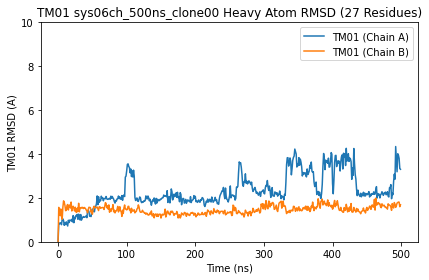

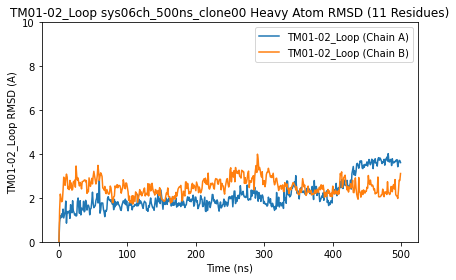

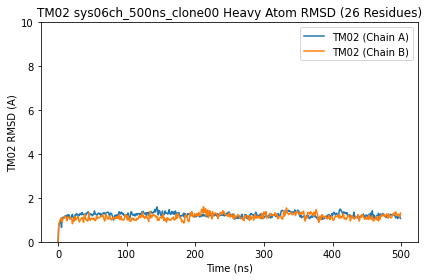

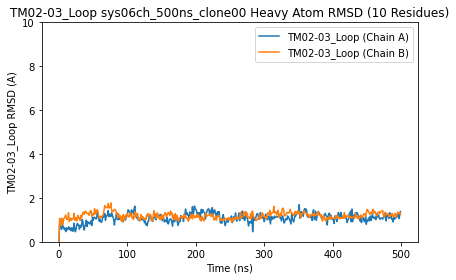

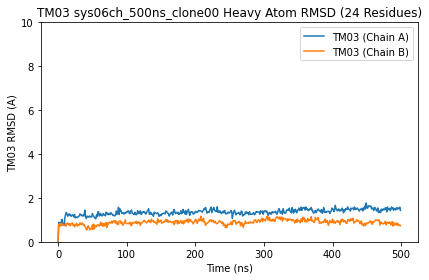

...

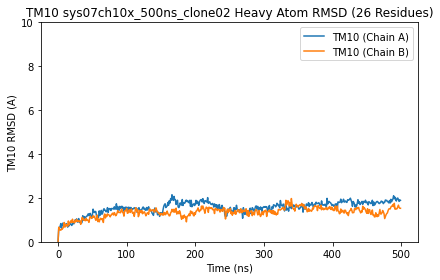

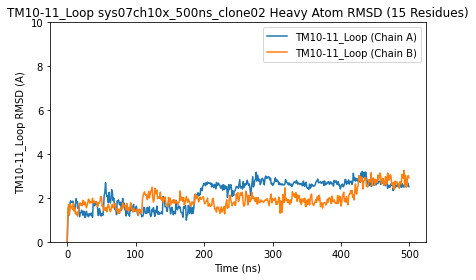

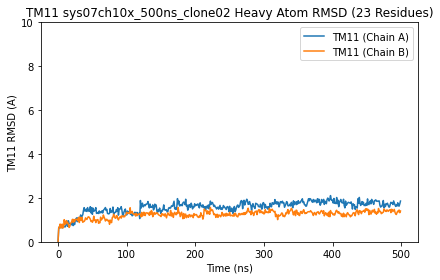

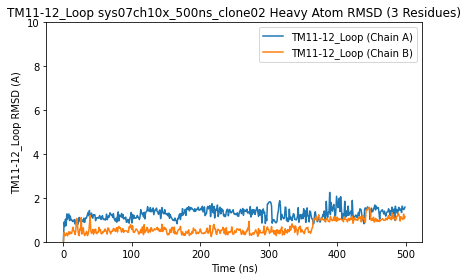

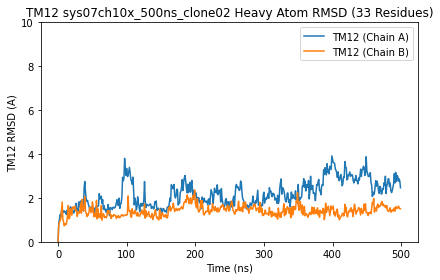

In [47]:
## Load in YAML file with correct MDTRAJ syntax
label_yaml_path = "../pymol-scripts/tmem175-RMSD-mdtraj-heavy-topology.yaml"
with open(label_yaml_path, 'r') as file: label_dict = yaml.safe_load(file)
    
for sys, info in sys_dict.items():
    t = info['traj']
    filename = 'rmsd-by-chain/' + sys + '_all_rmsds_by_chain.pdf'
    a.get_and_plot_rmsds_by_chain(t,
                            topo_dict=label_dict,
                                  title=f'{sys} Heavy Atom RMSD',
                             pdf_file=filename)

# Get Overall RMSD

In [ ]:
chain_dict = {'Protein Backbone': 'protein and backbone',
                  'Chain A': 'protein and backbone and chainid 0',
                   'Chain B': 'protein and backbone and chainid 1'}  
for sys, info in sys_dict.items():
    t = info['traj']
    filename = 'general-rmsd/' + sys + '_general_rmsd.pdf'
    a.get_and_plot_rmsds_single_plot(t,
                                 topo_dict = chain_dict,
                                     ref = info['Input PDB'],
                                 title=f'BB RMSD {info["Plot Title"]}',
                                pdf_file=filename)

## Overal RMSD without the 6-7 Loop

Protein Backbone protein and backbone and not residue 226 to 258 
Chain A protein and backbone and chainid 0 and not residue 226 to 258
Chain B protein and backbone and chainid 1 and not residue 226 to 258
Protein Backbone protein and backbone and not residue 226 to 258 
Chain A protein and backbone and chainid 0 and not residue 226 to 258
Chain B protein and backbone and chainid 1 and not residue 226 to 258
Protein Backbone protein and backbone and not residue 226 to 258 
Chain A protein and backbone and chainid 0 and not residue 226 to 258
Chain B protein and backbone and chainid 1 and not residue 226 to 258
Protein Backbone protein and backbone and not residue 226 to 258 
Chain A protein and backbone and chainid 0 and not residue 226 to 258
Chain B protein and backbone and chainid 1 and not residue 226 to 258
Protein Backbone protein and backbone and not residue 226 to 258 
Chain A protein and backbone and chainid 0 and not residue 226 to 258
Chain B protein and backbone and chainid

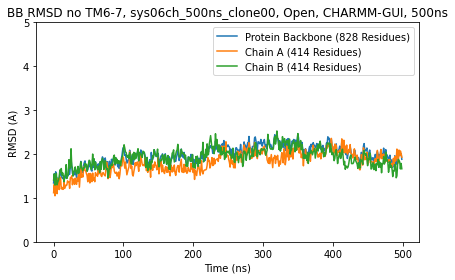

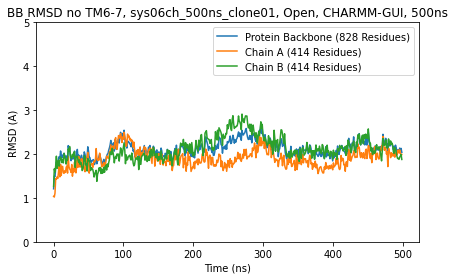

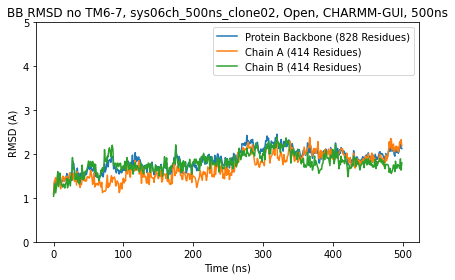

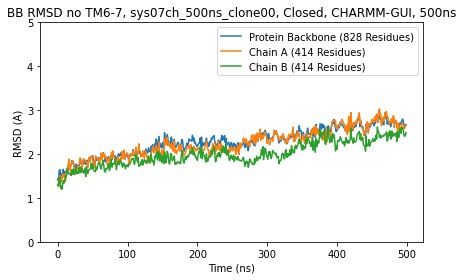

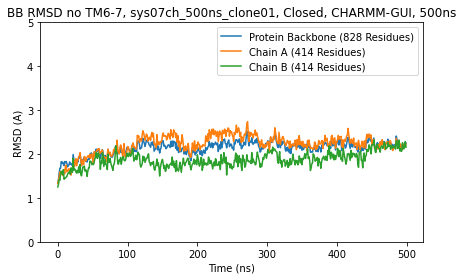

...

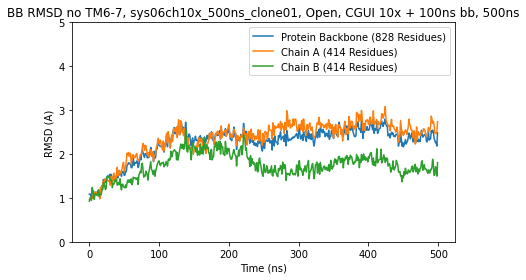

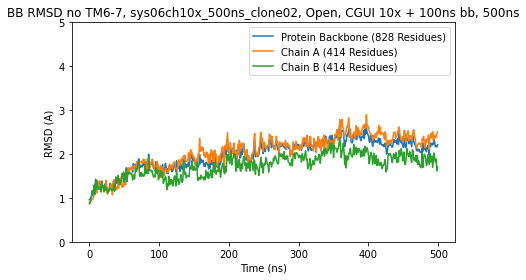

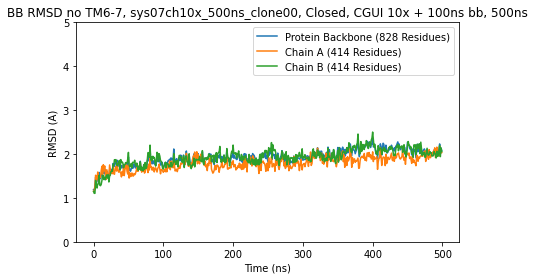

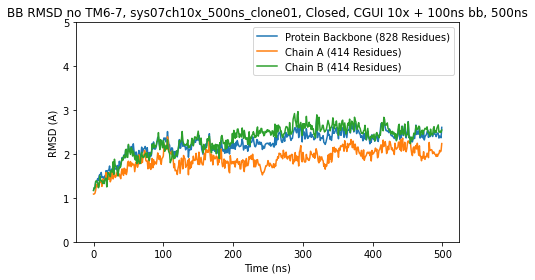

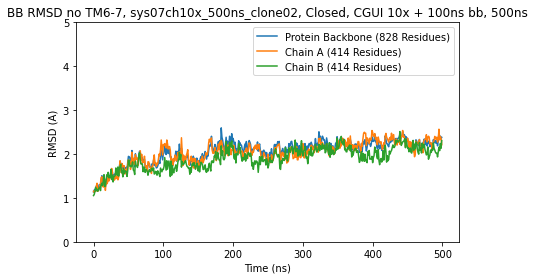

In [7]:

chain_dict = {'Protein Backbone': 'protein and backbone and not residue 226 to 258 ',
                  'Chain A': 'protein and backbone and chainid 0 and not residue 226 to 258',
                   'Chain B': 'protein and backbone and chainid 1 and not residue 226 to 258'}
for sys, info in sys_dict.items():
    t = info['traj']
    filename = 'general-rmsd/' + sys + '_rmsd_no_6_7_loop.pdf'
    a.get_and_plot_rmsds_single_plot(t,
                                 topo_dict = chain_dict,
                                     ref = info['Input PDB'],
                                 title=f'BB RMSD no TM6-7, {info["Plot Title"]}',
                                pdf_file=filename)

## Average RMSD

Protein Backbone protein and backbone and not residue 226 to 258 
Chain A protein and backbone and chainid 0 and not residue 226 to 258
Chain B protein and backbone and chainid 1 and not residue 226 to 258
Protein Backbone protein and backbone and not residue 226 to 258 
Chain A protein and backbone and chainid 0 and not residue 226 to 258
Chain B protein and backbone and chainid 1 and not residue 226 to 258
Protein Backbone protein and backbone and not residue 226 to 258 
Chain A protein and backbone and chainid 0 and not residue 226 to 258
Chain B protein and backbone and chainid 1 and not residue 226 to 258
Protein Backbone protein and backbone and not residue 226 to 258 
Chain A protein and backbone and chainid 0 and not residue 226 to 258
Chain B protein and backbone and chainid 1 and not residue 226 to 258
Protein Backbone protein and backbone and not residue 226 to 258 
Chain A protein and backbone and chainid 0 and not residue 226 to 258
Chain B protein and backbone and chainid

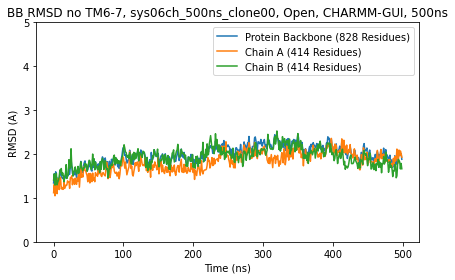

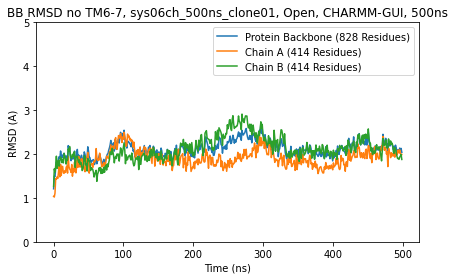

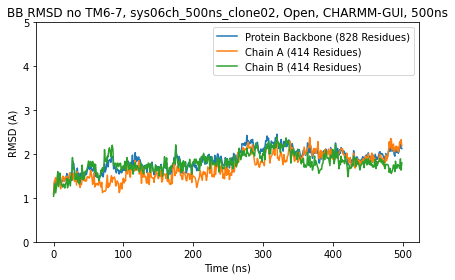

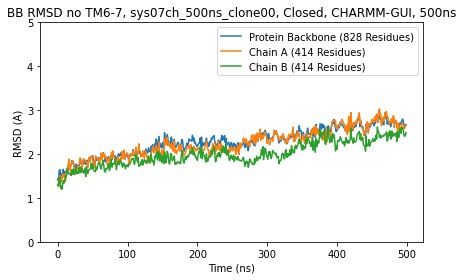

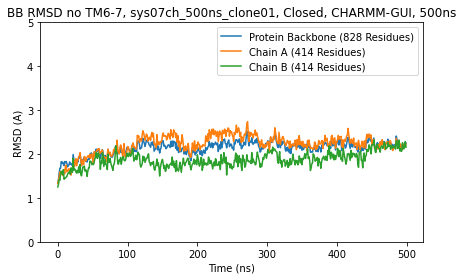

...

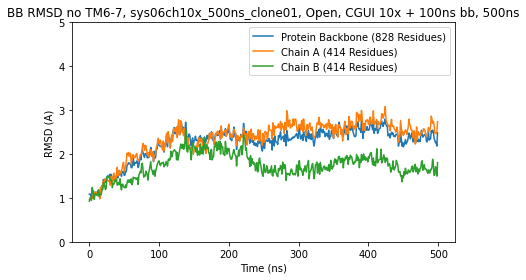

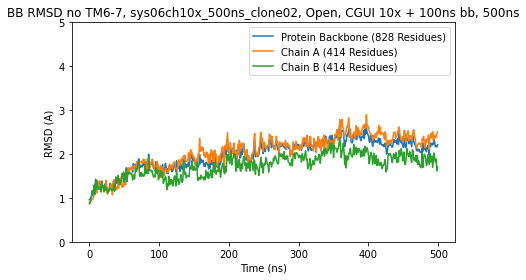

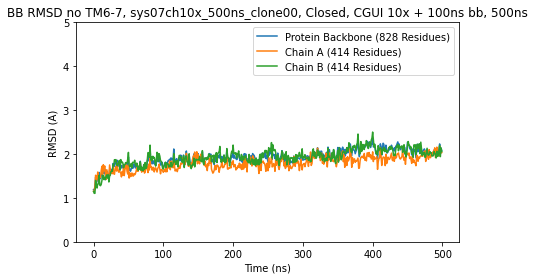

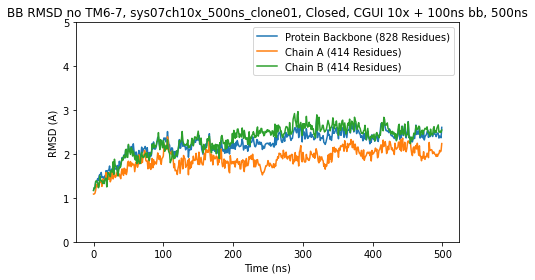

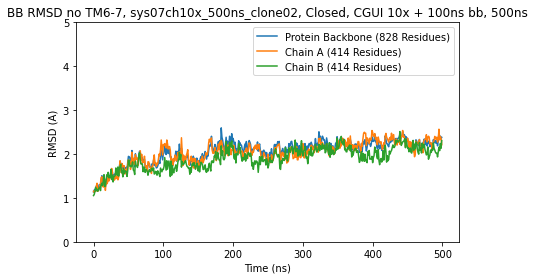

In [23]:
importlib.reload(a)
chain_dict = {'Protein Backbone': 'protein and backbone and not residue 226 to 258 ',
#                   'Chain A': 'protein and backbone and chainid 0 and not residue 226 to 258',
#                    'Chain B': 'protein and backbone and chainid 1 and not residue 226 to 258'
             }
for sys, info in sys_dict.items():
    t = info['traj']
    filename = 'general-rmsd/' + sys + '_rmsd_no_6_7_loop.pdf'
    total_rmsd = a.get_and_plot_rmsds_single_plot(t,
                                 topo_dict = chain_dict,
                                     ref = info['Input PDB'],
                                 title=f'BB RMSD no TM6-7, {info["Plot Title"]}',
                                pdf_file=filename)
    info['total_bb_rmsd'] = total_rmsd
    sys_dict[sys] = info

sys06ch_500ns_clone00 1.9802488
sys06ch_500ns_clone01 2.117198
sys06ch_500ns_clone02 1.870315
sys07ch_500ns_clone00 2.2840905
sys07ch_500ns_clone01 2.138834
sys07ch_500ns_clone02 2.0986762
sys06ch10x_500ns_clone00 1.7298623
sys06ch10x_500ns_clone01 2.2550488
sys06ch10x_500ns_clone02 1.9864916
sys07ch10x_500ns_clone00 1.927826
sys07ch10x_500ns_clone01 2.2510362
sys07ch10x_500ns_clone02 2.0648036


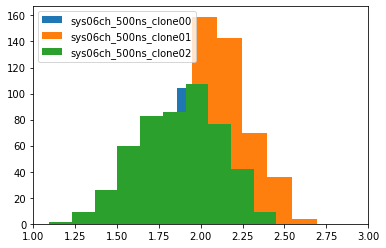

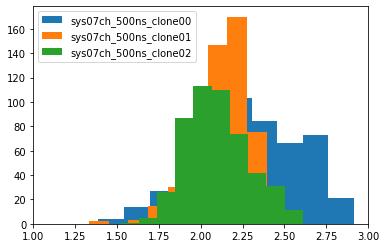

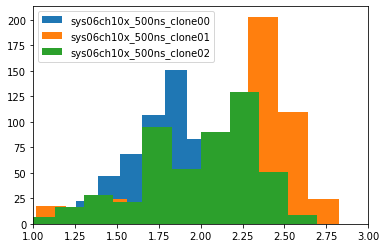

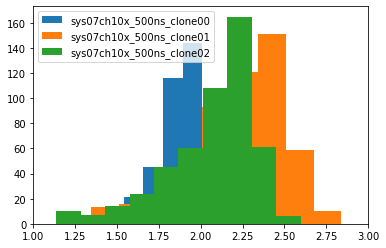

In [57]:
i = 0
for sys, info in sys_dict.items():
    if i % 3 == 0:
        plt.figure()
        plt.xlim([1,3])
    t = info['traj']
    total_rmsd = info['total_bb_rmsd']
    plt.hist(total_rmsd, label=sys)
    plt.legend()
    avg_rmsd = np.mean(total_rmsd)
    info['avg_total_bb_rmsd'] = avg_rmsd
    sys_dict[sys] = info
    print(sys, avg_rmsd)
    i+=1
    


# RMSD of the RxxFSD motif

RxxFSD Motif protein and (residue 35 or residue 39 or residue 40 or residue 41 or residue 92 or residue 95 or residue 113 or residue 264 or residue 265 or residue 266 or residue 280 or residue 324 or residue 345 or residue 347)
RxxFSD Motif protein and (residue 35 or residue 39 or residue 40 or residue 41 or residue 92 or residue 95 or residue 113 or residue 264 or residue 265 or residue 266 or residue 280 or residue 324 or residue 345 or residue 347)
RxxFSD Motif protein and (residue 35 or residue 39 or residue 40 or residue 41 or residue 92 or residue 95 or residue 113 or residue 264 or residue 265 or residue 266 or residue 280 or residue 324 or residue 345 or residue 347)
RxxFSD Motif protein and (residue 35 or residue 39 or residue 40 or residue 41 or residue 92 or residue 95 or residue 113 or residue 264 or residue 265 or residue 266 or residue 280 or residue 324 or residue 345 or residue 347)
RxxFSD Motif protein and (residue 35 or residue 39 or residue 40 or residue 41 or residu

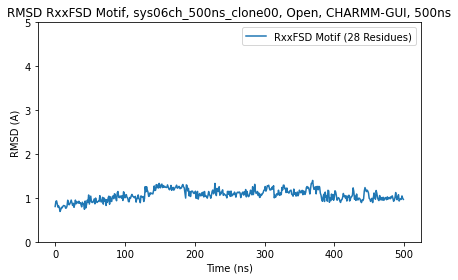

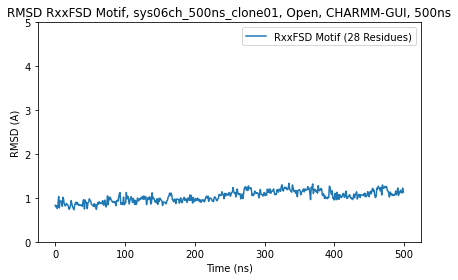

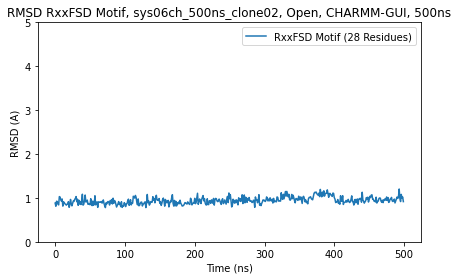

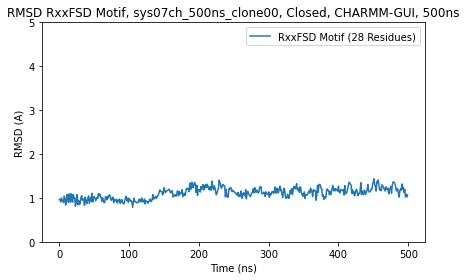

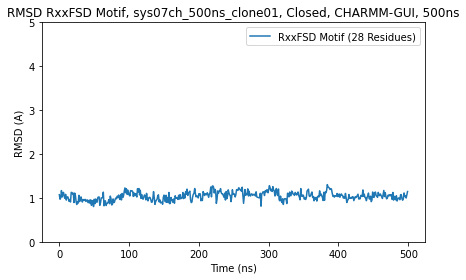

...

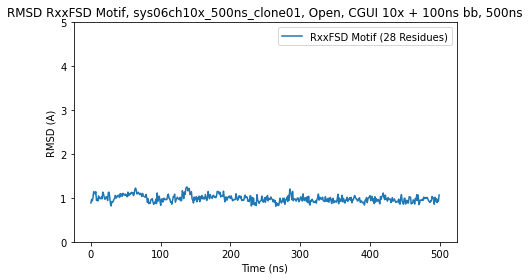

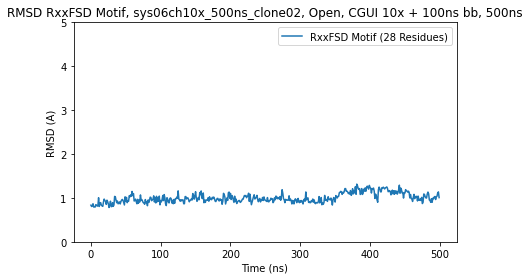

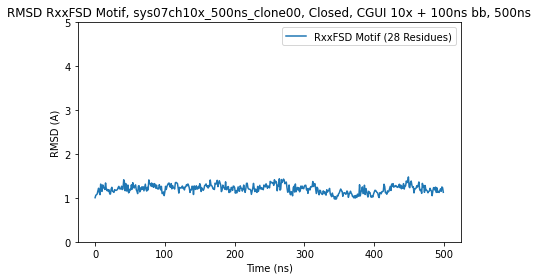

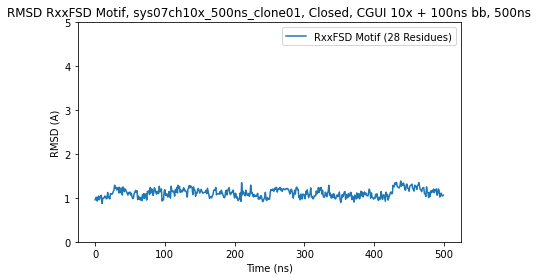

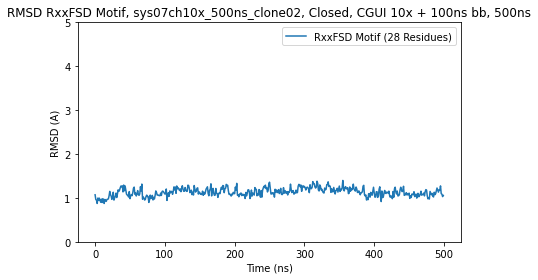

In [88]:
importlib.reload(a)
chain_dict = {'RxxFSD Motif': 'protein and (residue 35 or residue 39 or residue 40 or residue 41 or residue 92 or residue 95 or residue 113 or residue 264 or residue 265 or residue 266 or residue 280 or residue 324 or residue 345 or residue 347)',
#                   'Chain A': 'protein and backbone and chainid 0 and not residue 226 to 258',
#                    'Chain B': 'protein and backbone and chainid 1 and not residue 226 to 258'
             }
for sys, info in sys_dict.items():
    t = info['traj']
    filename = 'general-rmsd/' + sys + '_rmsd_RxxFSD_motif.pdf'
    total_rmsd = a.get_and_plot_rmsds_single_plot(t,
                                 topo_dict = chain_dict,
                                     ref = info['Input PDB'],
                                 title=f'RMSD RxxFSD Motif, {info["Plot Title"]}',
                                pdf_file=filename)
    info['RxxFSD_RMSD'] = total_rmsd
    sys_dict[sys] = info

sys06ch_500ns_clone00 1.062897
sys06ch_500ns_clone01 1.0297263
sys06ch_500ns_clone02 0.9402186
sys07ch_500ns_clone00 1.1066642
sys07ch_500ns_clone01 1.0407691
sys07ch_500ns_clone02 1.1087362
sys06ch10x_500ns_clone00 1.1751858
sys06ch10x_500ns_clone01 0.98474026
sys06ch10x_500ns_clone02 0.99932206
sys07ch10x_500ns_clone00 1.2076633
sys07ch10x_500ns_clone01 1.1105125
sys07ch10x_500ns_clone02 1.1305908


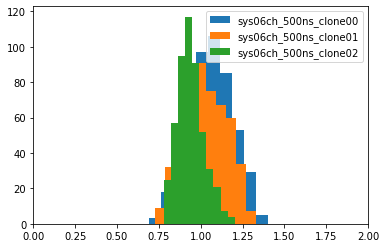

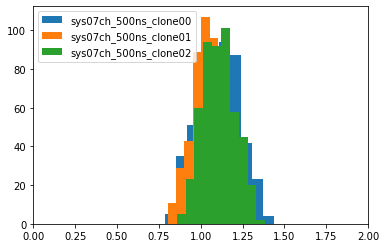

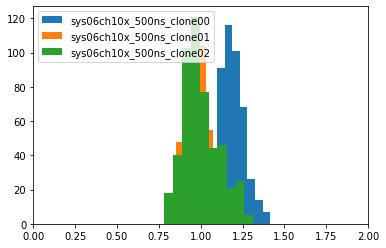

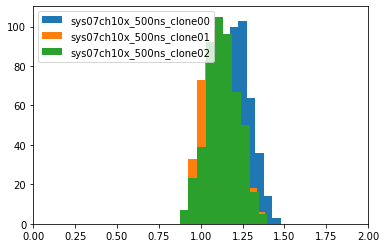

In [89]:
i = 0
for sys, info in sys_dict.items():
    if i % 3 == 0:
        sum_rmsd = 0
        plt.figure()
        plt.xlim([0,2])
    t = info['traj']
    total_rmsd = info['RxxFSD_RMSD']
    sum_rmsd += total_rmsd
    plt.hist(total_rmsd, label=sys)
    plt.legend()
    avg_rmsd = np.mean(total_rmsd)
    sys_dict[sys] = info
    if i % 3 == 2:
        avg_rmsd = np.mean(total_rmsd)
    print(sys, avg_rmsd)
    i+=1

## Per Residue RMSD

In [80]:
t = sys_dict['sys06ch10x_500ns_clone00']['traj']

In [81]:
def get_per_residue_RMSD_avg(t, topo_dict):
    md.rmsd(target=t,
                                 reference=ref,
                                 frame=0,
                                 atom_indices=idx)

<mdtraj.Trajectory with 500 frames, 151920 atoms, 31576 residues, and unitcells at 0x7fda9d138730>

# RMSD From One System to the Other (new)

In [ ]:
t_dict = {1: [sys_dict['sys06']['traj'], 'sys06'], 2: [sys_dict['sys06ch']['traj'], 'sys06ch']}
a.compare_rmsd_to_each_other(t_dict, 'not residue 226 to 258 and protein', 0)
plt.figure()
a.compare_rmsd_to_each_other(t_dict, 'not residue 226 to 258 and protein', -1)

In [ ]:
t_dict = {1: [sys_dict['sys07']['traj'], 'sys07'], 2: [sys_dict['sys07ch']['traj'], 'sys07ch']}
a.compare_rmsd_to_each_other(t_dict, 'not residue 226 to 258 and protein', 0)
plt.figure()
a.compare_rmsd_to_each_other(t_dict, 'not residue 226 to 258 and protein', -1)

# RMSF

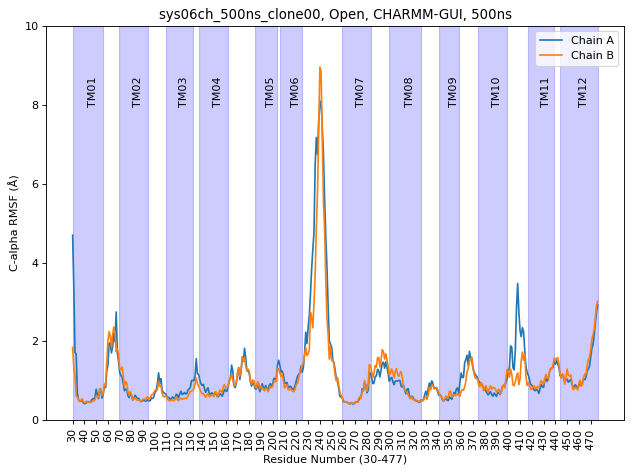

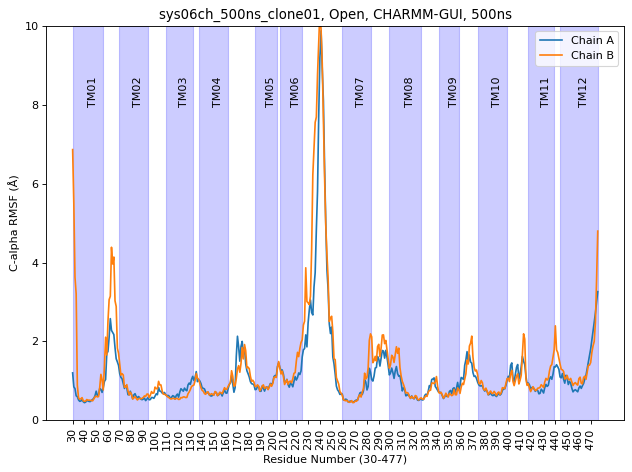

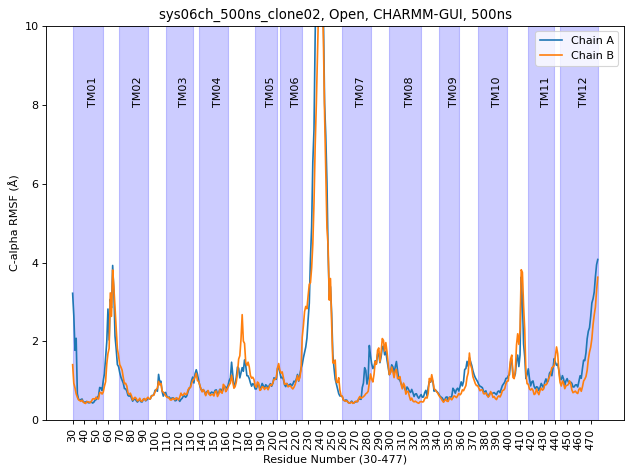

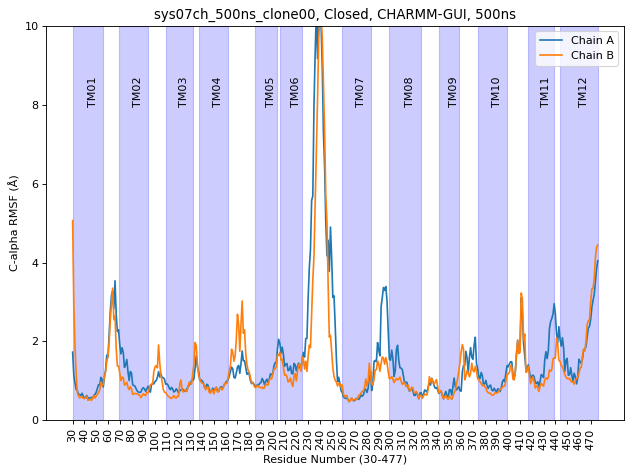

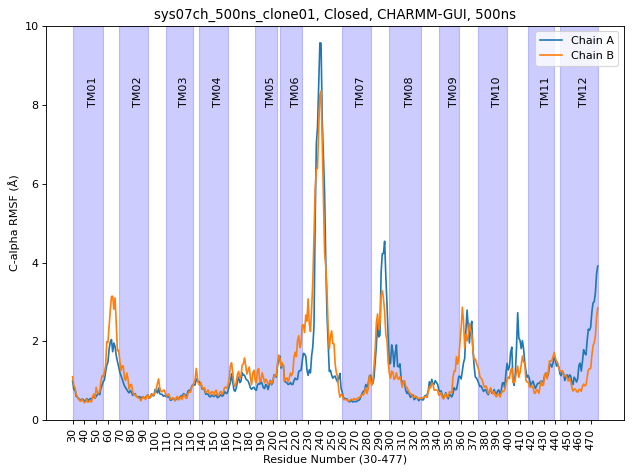

...

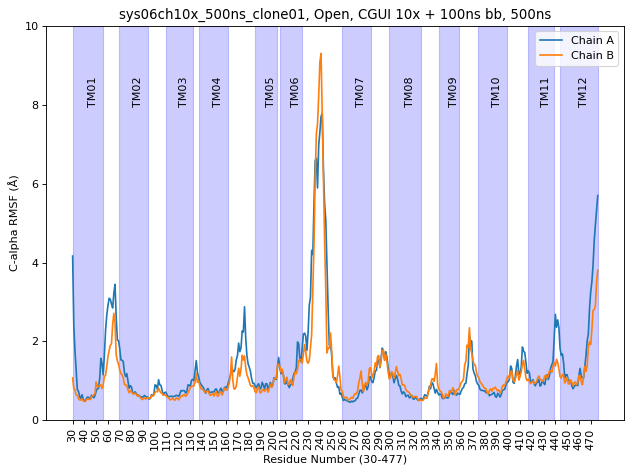

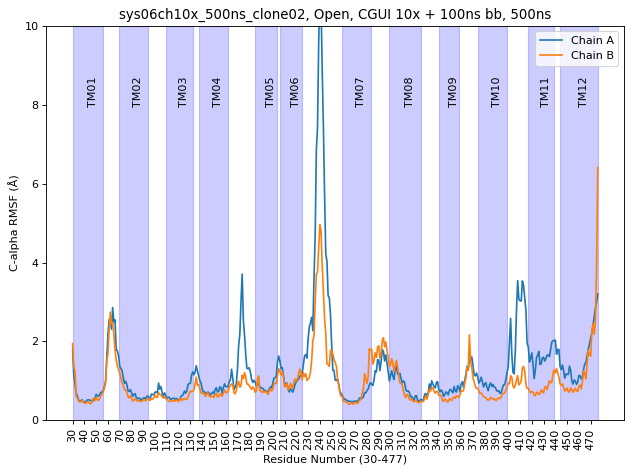

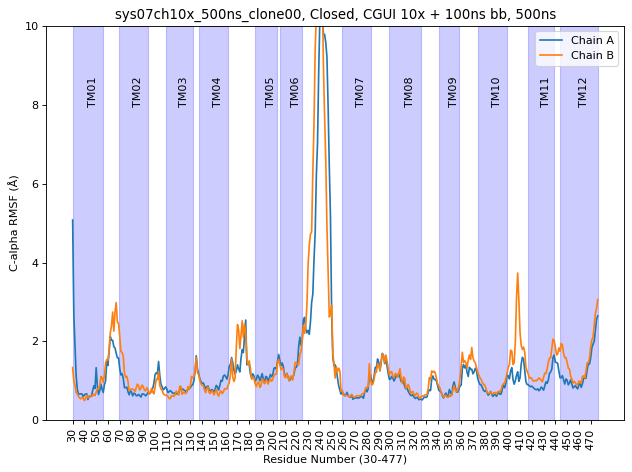

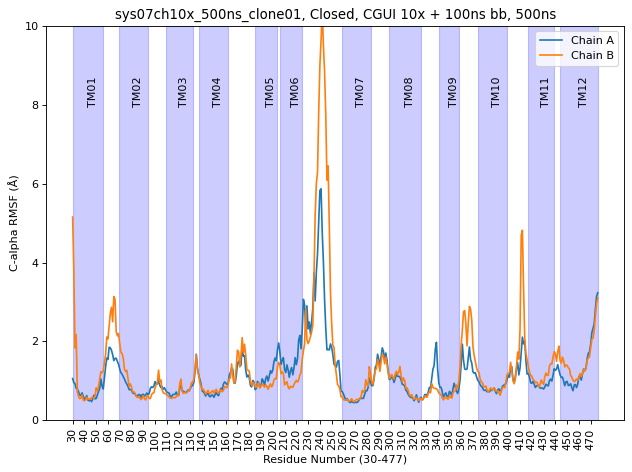

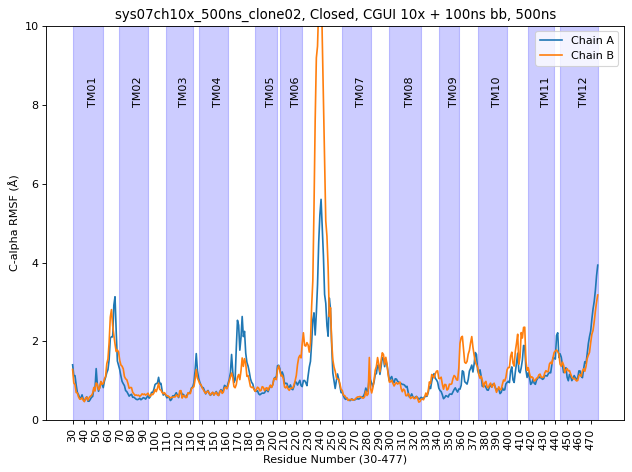

In [8]:
for sys, info in sys_dict.items():
    t = info['traj']
    filename = 'rmsf/' + sys + '_rmsf.pdf'
    a.get_and_plot_rmsf_by_chain(t, 
                                 title=info['Plot Title'], 
                                 pdf_file=filename)

## get total RMSF

In [62]:
sys_list = []
rmsf_list = []
for sys, info in sys_dict.items():
    t = info['traj']
    total_rmsf = a.get_total_rmsf(t)
    sys_list.append(sys)
    rmsf_list.append(total_rmsf)


In [65]:
sys_list

['sys06ch_500ns_clone00',
 'sys06ch_500ns_clone01',
 'sys06ch_500ns_clone02',
 'sys07ch_500ns_clone00',
 'sys07ch_500ns_clone01',
 'sys07ch_500ns_clone02',
 'sys06ch10x_500ns_clone00',
 'sys06ch10x_500ns_clone01',
 'sys06ch10x_500ns_clone02',
 'sys07ch10x_500ns_clone00',
 'sys07ch10x_500ns_clone01',
 'sys07ch10x_500ns_clone02']

In [63]:
rmsf_list

[100.59697,
 109.97264,
 115.41397,
 126.54207,
 109.44866,
 110.09934,
 97.28116,
 109.16511,
 100.09767,
 121.62074,
 111.000656,
 106.728516]

In [67]:
sys06_rmsf = np.mean(rmsf_list[0:2])
sys07_rmsf = np.mean(rmsf_list[3:5])
sys06ch10x_rmsf = np.mean(rmsf_list[6:8])
sys07ch10x_rmsf = np.mean(rmsf_list[9:11])

In [68]:
print(sys06_rmsf, sys06ch10x_rmsf, sys07_rmsf, sys07ch10x_rmsf)

105.284805 103.22313 117.99536 116.3107


# Activation Network

## the old way

In [ ]:
## get dist_dfs
for sys, info in sys_dict.items():
    info['an_df'] = a.get_activation_network_contacts(info['traj'])
    sys_dict[sys] = info

In [ ]:
for sys, info in sys_dict.items():
    filepath = 'feature-figures/' + sys + '_actnet_distvdist.pdf'
    title = f'{info["Title"]}, {info["State"]} Equilibrated with {info["Equilibration"]} and run for {info["Length"]}ns'
    a.plot_activation_network_dist_against_each_other(info['an_df'], 
                                                      title, 
                                                      filepath)

## the new way

## get names, idx_dict from activation_network_array

In [37]:
a.ACTIVATION_NETWORK_ARRAY

array([[[ 57,   0],
        [279,   0]],

       [[ 57,   0],
        [282,   0]],

       [[ 57,   0],
        [282,   1]],

       [[ 57,   0],
        [283,   1]],

       [[279,   0],
        [361,   0]]])

In [38]:
names1, idx_dict1 = a.get_mdtraj_idx_array(sys_dict['sys06ch10x_500ns_clone00']['traj'], a.ACTIVATION_NETWORK_ARRAY)

RES NUMBER, CHAIN: 57 0 279 0
RES ID: 27 249
RES NUMBER, CHAIN: 57 1 279 1
RES ID: 474 696
RES NUMBER, CHAIN: 57 0 282 0
RES ID: 27 252
RES NUMBER, CHAIN: 57 1 282 1
RES ID: 474 699
RES NUMBER, CHAIN: 57 0 282 1
RES ID: 27 699
RES NUMBER, CHAIN: 57 1 282 0
RES ID: 474 252
RES NUMBER, CHAIN: 57 0 283 1
RES ID: 27 700
RES NUMBER, CHAIN: 57 1 283 0
RES ID: 474 253
RES NUMBER, CHAIN: 279 0 361 0
RES ID: 249 331
RES NUMBER, CHAIN: 279 1 361 1
RES ID: 696 778


### this dict is used to get distance info

In [39]:
idx_dict1

{'ChainA': [[27, 249], [27, 252], [27, 699], [27, 700], [249, 331]],
 'ChainB': [[474, 696], [474, 699], [474, 252], [474, 253], [696, 778]]}

## use iterator to return chain_df_dict for each system

In [40]:
sys_dict = a.sys_dict_data_iterator(a.get_df_from_idx_dict,
                        sys_dict,
                         'an_long_df',
                        names1, 
                                    idx_dict1,
                                    return_long_df=True
                        )

sys06ch_500ns_clone00
sys06ch_500ns_clone01
sys06ch_500ns_clone02
sys07ch_500ns_clone00
sys07ch_500ns_clone01
sys07ch_500ns_clone02
sys06ch10x_500ns_clone00
sys06ch10x_500ns_clone01
sys06ch10x_500ns_clone02
sys07ch10x_500ns_clone00
sys07ch10x_500ns_clone01
sys07ch10x_500ns_clone02


In [42]:
chain_df_dict = sys_dict['sys06ch10x_500ns_clone00']['an_long_df']

In [43]:
chain_df_dict

,Time,Label,Minimum Heavy Atom Distance (Å),Chain
0,0,HIS57_0 to ASP279_0,2.782472,ChainA
1,1,HIS57_0 to ASP279_0,3.691261,ChainA
2,2,HIS57_0 to ASP279_0,2.972317,ChainA
3,3,HIS57_0 to ASP279_0,3.671433,ChainA
4,4,HIS57_0 to ASP279_0,3.045438,ChainA
...,...,...,...,...
2495,495,ASP279_0 to GLN361_0,11.383513,ChainB
2496,496,ASP279_0 to GLN361_0,10.031292,ChainB
2497,497,ASP279_0 to GLN361_0,11.379947,ChainB
2498,498,ASP279_0 to GLN361_0,11.048999,ChainB


## Plot Histograms

In [44]:
help(a.sys_dict_plot_iterator)

Help on function sys_dict_plot_iterator in module tmem_analysis:

sys_dict_plot_iterator(func, sys_dict, data_name, selector=False, pdf_dir=False, pdf_tag=False, update_layout_kwargs=False, update_xaxes_kwargs=False, update_yaxes_kwargs=False, update_traces_kwargs=False, **kwargs)



## use ACTIVATION_NETWORK_SCATTERPLOT_LIST

In [45]:
selection = a.ACTIVATION_NETWORK_SCATTERPLOT_LIST
selection

[[[0, 'HIS57_0 to ASP279_0'], [1, 'HIS57_0 to ASP279_0']],
 [[0, 'HIS57_0 to GLU282_1'], [1, 'HIS57_0 to GLU282_1']],
 [[0, 'HIS57_0 to GLU282_0'], [1, 'HIS57_0 to GLU282_0']],
 [[0, 'HIS57_0 to ASP279_0'], [0, 'HIS57_0 to GLU282_1']]]

In [46]:
importlib.reload(a)
a.sys_dict_plot_iterator(a.plot_dist_from_long_df,
                         sys_dict,
                         'an_long_df',
                         pdf_dir='activation-network',
                         pdf_tag='actnet_histograms',
                         update_layout_kwargs={
                             'height': 800,
                             'width': 1600,
                             'barmode': 'overlay'
                         },
                         update_yaxes_kwargs={
                             'range': [0,0.5]
                         },
                         update_traces_kwargs={
                             'opacity': 0.5,
                             'xbins': {'size': 0.25},
                         }
)

sys06ch_500ns_clone00
Showing figure...


Saving figure...
sys06ch_500ns_clone01
Showing figure...


Saving figure...
sys06ch_500ns_clone02
Showing figure...


Saving figure...
sys07ch_500ns_clone00
Showing figure...


Saving figure...
sys07ch_500ns_clone01
Showing figure...


Saving figure...
sys07ch_500ns_clone02
Showing figure...


Saving figure...
sys06ch10x_500ns_clone00
Showing figure...


Saving figure...
sys06ch10x_500ns_clone01
Showing figure...


Saving figure...
sys06ch10x_500ns_clone02
Showing figure...


Saving figure...
sys07ch10x_500ns_clone00
Showing figure...


Saving figure...
sys07ch10x_500ns_clone01
Showing figure...


Saving figure...
sys07ch10x_500ns_clone02
Showing figure...


Saving figure...


In [ ]:
importlib.reload(a)
import plotly.graph_objects as go
for name, info in sys_dict.items():
    chain_df_dict = info['an_dict']
    
    for pair in a.ACTIVATION_NETWORK_SCATTERPLOT_LIST:
        dist1 = pair[0][1].replace(' ', '_')
        dist2 = pair[1][1].replace(' ', '_')
        selection_dict = a.get_chain_df_dict_from_large_chain_df_dict(chain_df_dict, pair)
        if len(selection_dict.keys()) == 1:
            fig = a.plot_distances_across_chains(selection_dict)
            fig.update_xaxes(range=[2,11], dtick=1, title_text = f'Chain A Min Heavy Atom Dist (Å)')
            fig.update_yaxes(range=[2,11], dtick=1, title_text = f'Chain B Min Heavy Atom Dist (Å)')
            fig.update_layout(height=600, width=700)
            selection = f'{name}_{dist1}_Chain_Comparison'
            
        elif len(selection_dict.keys()) > 1:
            selection = f'{name}_{dist1}_{dist2}'
            fig = a.plot_distances_both_chains(selection_dict)
            fig.update_xaxes(range=[2,11], 
                             dtick=1
                            )
            fig.update_yaxes(range=[2,11], 
                             dtick=1
                            )
            fig.update_layout(height=600, width=1100)

            fig.update_xaxes(title_text=f'{dist1} Min Heavy Atom Dist (Å)', row=1, col=1)
            fig.update_yaxes(title_text=f'{dist2} Min Heavy Atom Dist (Å)', row=1, col=1)
        margin=go.layout.Margin(
            l=50, #left margin
            r=0, #right margin
            b=50, #bottom margin
            t=50,  #top margin
        )
        
        fig.update_layout(margin=margin)
        fig.update_layout(title=selection, font_size=16)
        filename = f'scatterplots/{selection}_scatter.pdf'
        fig.write_image(filename)

# Plot RxxxFSD Motif

In [48]:
names, idx_dict = a.get_mdtraj_idx_array(sys_dict['sys06ch10x_500ns_clone00']['traj'],a.RxxxFSD_MOTIF_ARRAY)

RES NUMBER, CHAIN: 35 0 327 1
RES ID: 5 744
RES NUMBER, CHAIN: 35 1 327 0
RES ID: 452 297
RES NUMBER, CHAIN: 35 0 266 1
RES ID: 5 683
RES NUMBER, CHAIN: 35 1 266 0
RES ID: 452 236
RES NUMBER, CHAIN: 39 0 324 1
RES ID: 9 741
RES NUMBER, CHAIN: 39 1 324 0
RES ID: 456 294
RES NUMBER, CHAIN: 40 0 113 0
RES ID: 10 83
RES NUMBER, CHAIN: 40 1 113 1
RES ID: 457 530
RES NUMBER, CHAIN: 41 0 92 0
RES ID: 11 62
RES NUMBER, CHAIN: 41 1 92 1
RES ID: 458 509
RES NUMBER, CHAIN: 41 0 260 0
RES ID: 11 230
RES NUMBER, CHAIN: 41 1 260 1
RES ID: 458 677
RES NUMBER, CHAIN: 92 0 264 0
RES ID: 62 234
RES NUMBER, CHAIN: 92 1 264 1
RES ID: 509 681
RES NUMBER, CHAIN: 95 0 113 0
RES ID: 65 83
RES NUMBER, CHAIN: 95 1 113 1
RES ID: 512 530
RES NUMBER, CHAIN: 95 0 260 0
RES ID: 65 230
RES NUMBER, CHAIN: 95 1 260 1
RES ID: 512 677
RES NUMBER, CHAIN: 265 0 345 0
RES ID: 235 315
RES NUMBER, CHAIN: 265 1 345 1
RES ID: 682 762
RES NUMBER, CHAIN: 266 0 324 0
RES ID: 236 294
RES NUMBER, CHAIN: 266 1 324 1
RES ID: 683 741
R

In [49]:
idx_dict

{'ChainA': [[5, 744],
  [5, 683],
  [9, 741],
  [10, 83],
  [11, 62],
  [11, 230],
  [62, 234],
  [65, 83],
  [65, 230],
  [235, 315],
  [236, 294],
  [297, 315]],
 'ChainB': [[452, 297],
  [452, 236],
  [456, 294],
  [457, 530],
  [458, 509],
  [458, 677],
  [509, 681],
  [512, 530],
  [512, 677],
  [682, 762],
  [683, 741],
  [744, 762]]}

## use iterator to get data

In [50]:
importlib.reload(a)
sys_dict = a.sys_dict_data_iterator(a.get_df_from_idx_dict,
                        sys_dict,
                         f'RxxxFSD',
                        names, 
                                    idx_dict,
                                    return_long_df=True
                        )

sys06ch_500ns_clone00
sys06ch_500ns_clone01
sys06ch_500ns_clone02
sys07ch_500ns_clone00
sys07ch_500ns_clone01
sys07ch_500ns_clone02
sys06ch10x_500ns_clone00
sys06ch10x_500ns_clone01
sys06ch10x_500ns_clone02
sys07ch10x_500ns_clone00
sys07ch10x_500ns_clone01
sys07ch10x_500ns_clone02


In [ ]:
sys_dict['sys06ch10x_100ns_clone00']['RxxxFSD']

In [ ]:
help(a.plot_dist_from_long_df)

In [ ]:
help(a.sys_dict_plot_iterator)

In [ ]:
a.RxxxFSD_DIST_LABELS

In [69]:
importlib.reload(a)
for label, selection in a.RxxxFSD_DIST_LABELS.items():
    a.sys_dict_plot_iterator(a.plot_dist_from_long_df,
                            sys_dict,
                            f'RxxxFSD',
                             selector=selection,
                            pdf_dir='RxxxFSD-motif',
                            pdf_tag=label,
                            update_xaxes_kwargs={'range': [2.0, 4.5]},
                            update_yaxes_kwargs={'range': [0, 0.6]},
                            update_traces_kwargs={'xbins': {'start': 2.0, 'end': 4.5, 'size': 0.1},
                                                 'opacity':0.5},
                             update_layout_kwargs={'barmode': 'overlay'}
                            )

sys06ch_500ns_clone00
Showing figure...


Saving figure...
sys06ch_500ns_clone01
Showing figure...


Saving figure...
sys06ch_500ns_clone02
Showing figure...


Saving figure...
sys07ch_500ns_clone00
Showing figure...


Saving figure...
sys07ch_500ns_clone01
Showing figure...


Saving figure...
sys07ch_500ns_clone02
Showing figure...


Saving figure...
sys06ch10x_500ns_clone00
Showing figure...


Saving figure...
sys06ch10x_500ns_clone01
Showing figure...


Saving figure...
sys06ch10x_500ns_clone02
Showing figure...


Saving figure...
sys07ch10x_500ns_clone00
Showing figure...


Saving figure...
sys07ch10x_500ns_clone01
Showing figure...


Saving figure...
sys07ch10x_500ns_clone02
Showing figure...


Saving figure...
sys06ch_500ns_clone00
Showing figure...


Saving figure...
sys06ch_500ns_clone01
Showing figure...


Saving figure...
sys06ch_500ns_clone02
Showing figure...


Saving figure...
sys07ch_500ns_clone00
Showing figure...


Saving figure...
sys07ch_500ns_clone01
Showing figure...


Saving figure...
sys07ch_500ns_clone02
Showing figure...


Saving figure...
sys06ch10x_500ns_clone00
Showing figure...


Saving figure...
sys06ch10x_500ns_clone01
Showing figure...


Saving figure...
sys06ch10x_500ns_clone02
Showing figure...


Saving figure...
sys07ch10x_500ns_clone00
Showing figure...


Saving figure...
sys07ch10x_500ns_clone01
Showing figure...


Saving figure...
sys07ch10x_500ns_clone02
Showing figure...


Saving figure...
sys06ch_500ns_clone00
Showing figure...


Saving figure...
sys06ch_500ns_clone01
Showing figure...


Saving figure...
sys06ch_500ns_clone02
Showing figure...


Saving figure...
sys07ch_500ns_clone00
Showing figure...


Saving figure...
sys07ch_500ns_clone01
Showing figure...


Saving figure...
sys07ch_500ns_clone02
Showing figure...


Saving figure...
sys06ch10x_500ns_clone00
Showing figure...


Saving figure...
sys06ch10x_500ns_clone01
Showing figure...


Saving figure...
sys06ch10x_500ns_clone02
Showing figure...


Saving figure...
sys07ch10x_500ns_clone00
Showing figure...


Saving figure...
sys07ch10x_500ns_clone01
Showing figure...


Saving figure...
sys07ch10x_500ns_clone02
Showing figure...


Saving figure...
sys06ch_500ns_clone00
Showing figure...


Saving figure...
sys06ch_500ns_clone01
Showing figure...


Saving figure...
sys06ch_500ns_clone02
Showing figure...


Saving figure...
sys07ch_500ns_clone00
Showing figure...


Saving figure...
sys07ch_500ns_clone01
Showing figure...


Saving figure...
sys07ch_500ns_clone02
Showing figure...


Saving figure...
sys06ch10x_500ns_clone00
Showing figure...


Saving figure...
sys06ch10x_500ns_clone01
Showing figure...


Saving figure...
sys06ch10x_500ns_clone02
Showing figure...


Saving figure...
sys07ch10x_500ns_clone00
Showing figure...


Saving figure...
sys07ch10x_500ns_clone01
Showing figure...


Saving figure...
sys07ch10x_500ns_clone02
Showing figure...


Saving figure...
sys06ch_500ns_clone00
Showing figure...


Saving figure...
sys06ch_500ns_clone01
Showing figure...


Saving figure...
sys06ch_500ns_clone02
Showing figure...


Saving figure...
sys07ch_500ns_clone00
Showing figure...


Saving figure...
sys07ch_500ns_clone01
Showing figure...


Saving figure...
sys07ch_500ns_clone02
Showing figure...


Saving figure...
sys06ch10x_500ns_clone00
Showing figure...


Saving figure...
sys06ch10x_500ns_clone01
Showing figure...


Saving figure...
sys06ch10x_500ns_clone02
Showing figure...


Saving figure...
sys07ch10x_500ns_clone00
Showing figure...


Saving figure...
sys07ch10x_500ns_clone01
Showing figure...


Saving figure...
sys07ch10x_500ns_clone02
Showing figure...


Saving figure...
sys06ch_500ns_clone00
Showing figure...


Saving figure...
sys06ch_500ns_clone01
Showing figure...


Saving figure...
sys06ch_500ns_clone02
Showing figure...


Saving figure...
sys07ch_500ns_clone00
Showing figure...


Saving figure...
sys07ch_500ns_clone01
Showing figure...


Saving figure...
sys07ch_500ns_clone02
Showing figure...


Saving figure...
sys06ch10x_500ns_clone00
Showing figure...


Saving figure...
sys06ch10x_500ns_clone01
Showing figure...


Saving figure...
sys06ch10x_500ns_clone02
Showing figure...


Saving figure...
sys07ch10x_500ns_clone00
Showing figure...


Saving figure...
sys07ch10x_500ns_clone01
Showing figure...


Saving figure...
sys07ch10x_500ns_clone02
Showing figure...


Saving figure...
